# V/ Modélisation avec l'algorithme Transfer Learning

## V.1) Classification Binaire

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

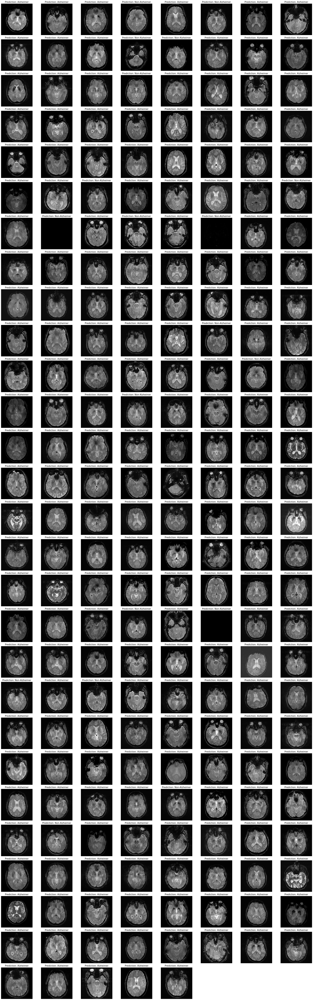

In [3]:
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Input, Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Function to load and preprocess images
def load_and_preprocess_images(path, target_size=(256, 256)):
    images = []
    for image_file in os.listdir(path):
        if image_file != '.ipynb_checkpoints':
            image = tf.keras.preprocessing.image.load_img(
                os.path.join(path, image_file),
                target_size=target_size
            )
            image = tf.keras.preprocessing.image.img_to_array(image)
            images.append(image)
    return np.array(images)

# Define the paths to the folders containing the images
trainCN_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/validation/trainCN'
trainADLMCIMCIEMCI_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/validation/trainAD_EMCI_LMCI_MCI'
testCN_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/validation/testCN'
testADLMCIMCIEMCI_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/validation/testAD_EMCI_LMCI_MCI'

# Load and preprocess the images
trainCN_images = load_and_preprocess_images(trainCN_path, target_size=(224, 224))
trainADLMCIMCIEMCI_images = load_and_preprocess_images(trainADLMCIMCIEMCI_path, target_size=(224, 224))
testCN_images = load_and_preprocess_images(testCN_path, target_size=(224, 224))
testADLMCIMCIEMCI_images = load_and_preprocess_images(testADLMCIMCIEMCI_path, target_size=(224, 224))

# Normalize the images to scale between 0 and 1
trainCN_images = trainCN_images / 255.0
trainADLMCIMCIEMCI_images = trainADLMCIMCIEMCI_images / 255.0
testCN_images = testCN_images / 255.0
testADLMCIMCIEMCI_images = testADLMCIMCIEMCI_images / 255.0

# Concatenate images and labels
train_images = np.concatenate((trainCN_images, trainADLMCIMCIEMCI_images), axis=0)
test_images = np.concatenate((testCN_images, testADLMCIMCIEMCI_images), axis=0)

train_labels = np.concatenate((np.zeros(trainCN_images.shape[0]), np.ones(trainADLMCIMCIEMCI_images.shape[0])), axis=0)
test_labels = np.concatenate((np.zeros(testCN_images.shape[0]), np.ones(testADLMCIMCIEMCI_images.shape[0])), axis=0)

# Split the data into training, validation, and test sets
train_images, val_test_images, train_labels, val_test_labels = train_test_split(
    train_images, train_labels, test_size=0.4, random_state=42
)
val_images, test_images, val_labels, test_labels = train_test_split(
    val_test_images, val_test_labels, test_size=0.5, random_state=42
)

# Use the pre-trained VGG16 model (excluding the top classification layers)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the layers of the pre-trained model so they are not trainable
for layer in base_model.layers:
    layer.trainable = False

# Add our own classification layers on top of the pre-trained model
x = Flatten()(base_model.output)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
output_layer = Dense(1, activation='sigmoid')(x)

# Create the transfer learning model
transfer_model = Model(inputs=base_model.input, outputs=output_layer)

# Compile the model
transfer_model.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

# Display model summary
transfer_model.summary()

# Train the transfer learning model
transfer_model.fit(train_images, train_labels, epochs=10, batch_size=32, shuffle=True, validation_data=(val_images, val_labels))

# Evaluate the model on the test data
y_pred = transfer_model.predict(test_images)
y_pred = (y_pred > 0.5).astype(int)  # Convert probabilities to binary predictions (0 or 1)

# Calculate evaluation metrics
accuracy = accuracy_score(test_labels, y_pred)
precision = precision_score(test_labels, y_pred)
recall = recall_score(test_labels, y_pred)
f1 = f1_score(test_labels, y_pred)
confusion = confusion_matrix(test_labels, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)
print("Confusion Matrix:")
print(confusion)

# Display test images with their predictions
n = len(test_images)
num_rows = 30
num_cols = (n + num_rows - 1) // num_rows

plt.figure(figsize=(30, 100))

for i in range(n):
    ax = plt.subplot(num_rows, num_cols, i + 1)
    plt.imshow(test_images[i], cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title(f"Prediction: {'Alzheimer' if y_pred[i] == 1 else 'Non-Alzheimer'}", fontsize=15)
    plt.axis('off')

plt.tight_layout()
plt.show()


## V.2) Classification Multiclasse


Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

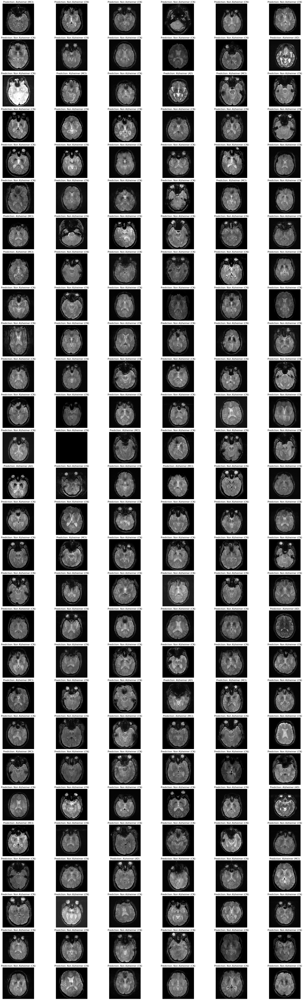

In [4]:
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Input, Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Function to load and preprocess images
def load_and_preprocess_images(path, target_size=(256, 256)):
    images = []
    for image_file in os.listdir(path):
        if image_file != '.ipynb_checkpoints':
            image = tf.keras.preprocessing.image.load_img(
                os.path.join(path, image_file),
                target_size=target_size
            )
            image = tf.keras.preprocessing.image.img_to_array(image)
            images.append(image)
    return np.array(images)

# Define the paths to the folders containing the images
trainCN_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/train/Final CN JPEG'
trainAD_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/train/Final AD JPEG'
trainMCI_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/train/Final MCI JPEG'
testCN_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/test/Final CN JPEG'
testAD_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/test/Final AD JPEG'
testMCI_path = 'E:/StageEsprit/Archive6ADNI/AlzheimersADNI/test/Final MCI JPEG'

# Load and preprocess the images
trainCN_images = load_and_preprocess_images(trainCN_path, target_size=(224, 224))
trainAD_images = load_and_preprocess_images(trainAD_path, target_size=(224, 224))
trainMCI_images = load_and_preprocess_images(trainMCI_path, target_size=(224, 224))
testCN_images = load_and_preprocess_images(testCN_path, target_size=(224, 224))
testAD_images = load_and_preprocess_images(testAD_path, target_size=(224, 224))
testMCI_images = load_and_preprocess_images(testMCI_path, target_size=(224, 224))

# Normalize the images to scale between 0 and 1
trainCN_images = trainCN_images / 255.0
trainAD_images = trainAD_images / 255.0
trainMCI_images = trainMCI_images / 255.0
testCN_images = testCN_images / 255.0
testAD_images = testAD_images / 255.0
testMCI_images = testMCI_images / 255.0

# Concatenate images and labels
train_images = np.concatenate((trainCN_images, trainAD_images, trainMCI_images), axis=0)
test_images = np.concatenate((testCN_images, testAD_images, testMCI_images), axis=0)

train_labels = np.concatenate((np.zeros(trainCN_images.shape[0]), np.ones(trainAD_images.shape[0]), 2*np.ones(trainMCI_images.shape[0])), axis=0)
test_labels = np.concatenate((np.zeros(testCN_images.shape[0]), np.ones(testAD_images.shape[0]), 2*np.ones(testMCI_images.shape[0])), axis=0)

# Split the data into training, validation, and test sets
train_images, val_test_images, train_labels, val_test_labels = train_test_split(
    train_images, train_labels, test_size=0.4, random_state=42
)
val_images, test_images, val_labels, test_labels = train_test_split(
    val_test_images, val_test_labels, test_size=0.5, random_state=42
)

# Use the pre-trained VGG16 model (excluding the top classification layers)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the layers of the pre-trained model so they are not trainable
for layer in base_model.layers:
    layer.trainable = False

# Add our own classification layers on top of the pre-trained model
x = Flatten()(base_model.output)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
output_layer = Dense(3, activation='softmax')(x)  # Change activation to softmax for multiclass

# Create the transfer learning model
transfer_model = Model(inputs=base_model.input, outputs=output_layer)

# Compile the model
transfer_model.compile(optimizer=Adam(learning_rate=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Display model summary
transfer_model.summary()

# Train the transfer learning model
transfer_model.fit(train_images, train_labels, epochs=10, batch_size=32, shuffle=True, validation_data=(val_images, val_labels))

# Evaluate the model on the test data
y_pred = transfer_model.predict(test_images)
y_pred_classes = np.argmax(y_pred, axis=1)  # Convert probabilities to class predictions

# Calculate evaluation metrics
accuracy = accuracy_score(test_labels, y_pred_classes)
precision = precision_score(test_labels, y_pred_classes, average='weighted')
recall = recall_score(test_labels, y_pred_classes, average='weighted')
f1 = f1_score(test_labels, y_pred_classes, average='weighted')
confusion = confusion_matrix(test_labels, y_pred_classes)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)
print("Confusion Matrix:")
print(confusion)

# Display test images with their predictions
n = len(test_images)
num_rows = 30
num_cols = (n + num_rows - 1) // num_rows

plt.figure(figsize=(30, 100))

for i in range(n):
    ax = plt.subplot(num_rows, num_cols, i + 1)
    plt.imshow(test_images[i], cmap='gray')
    plt.xticks([])
    plt.yticks([])
    predicted_class = y_pred_classes[i]
    if predicted_class == 0:
        prediction_label = "Non Alzheimer (CN)"
    elif predicted_class == 1:
        prediction_label = "Alzheimer (AD)"
    else:
        prediction_label = "Alzheimer (MCI)"
    plt.title(f"Prediction: {prediction_label}", fontsize=15)
    plt.axis('off')

plt.tight_layout()
plt.show()

